In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
import geopandas as gpd
from sklearn.cluster import KMeans

In [2]:
df = pd.read_csv('data/kc_house_data.csv')

In [3]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [5]:
df.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


In [6]:
df = df.drop_duplicates()

In [7]:
df['date'] = pd.to_datetime(df['date'])
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month

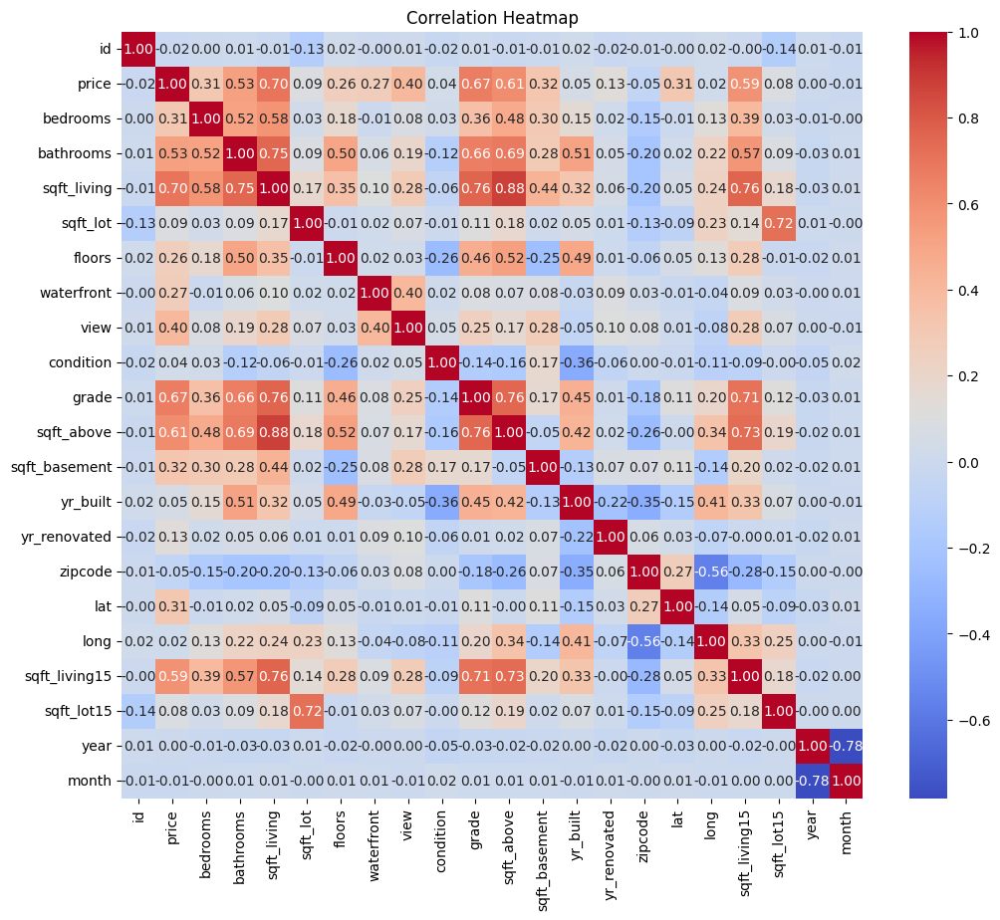

In [8]:
plt.figure(figsize=(12, 10))
sns.heatmap(df.corr(numeric_only=True), annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Correlation Heatmap")
plt.show()

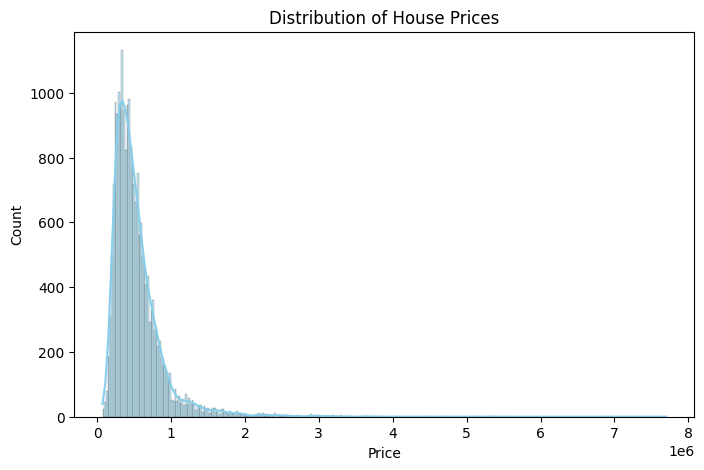

In [9]:
plt.figure(figsize=(8, 5))
sns.histplot(df['price'], kde=True, color='skyblue')
plt.title("Distribution of House Prices")
plt.xlabel("Price")
plt.show()

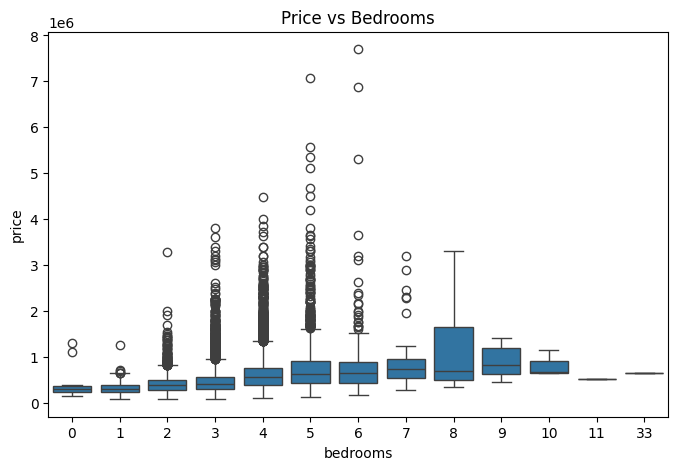

In [10]:
plt.figure(figsize=(8, 5))
sns.boxplot(x='bedrooms', y='price', data=df)
plt.title("Price vs Bedrooms")
plt.show()

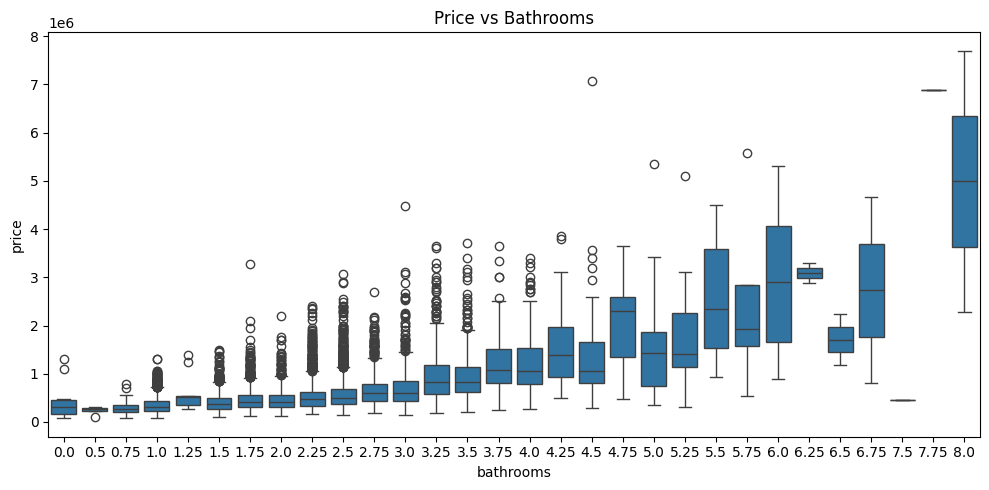

In [11]:
plt.figure(figsize=(10, 5))
sns.boxplot(x='bathrooms', y='price', data=df)
plt.title("Price vs Bathrooms")
plt.tight_layout()
plt.show()

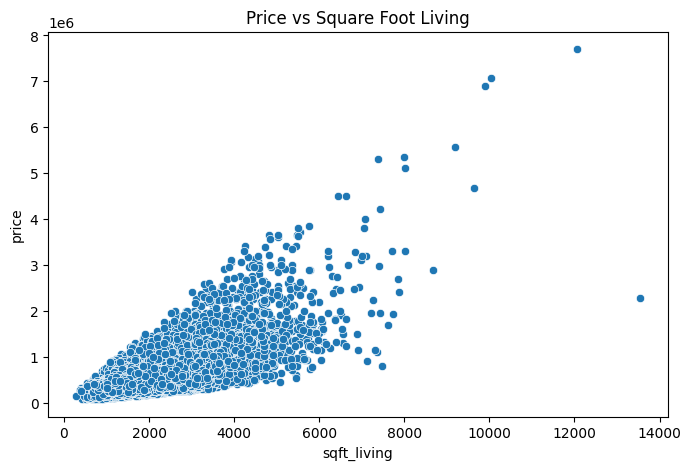

In [12]:
plt.figure(figsize=(8, 5))
sns.scatterplot(x='sqft_living', y='price', data=df)
plt.title("Price vs Square Foot Living")
plt.show()

In [13]:
df['age'] = df['year'] - df['yr_built']
df['renovated_age'] = np.where(df['yr_renovated'] == 0,
                               df['age'],
                               df['year'] - df['yr_renovated'])


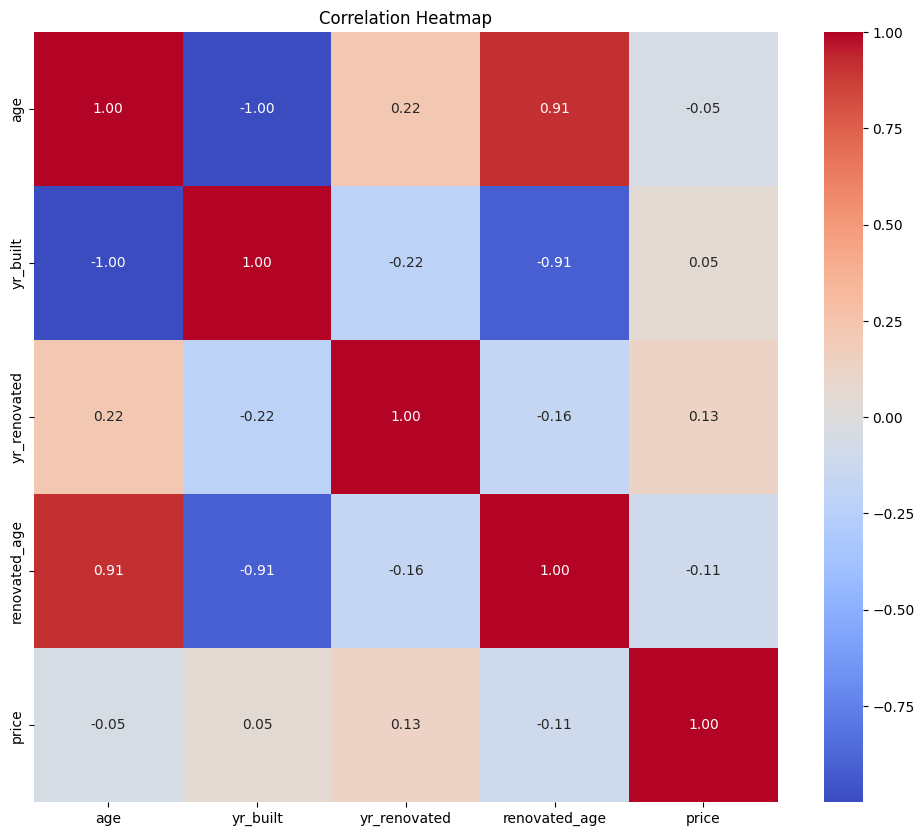

In [14]:
plt.figure(figsize=(12, 10))
sns.heatmap(df[['age', 'yr_built', 'yr_renovated','renovated_age','price']].corr(), annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Correlation Heatmap")
plt.show()

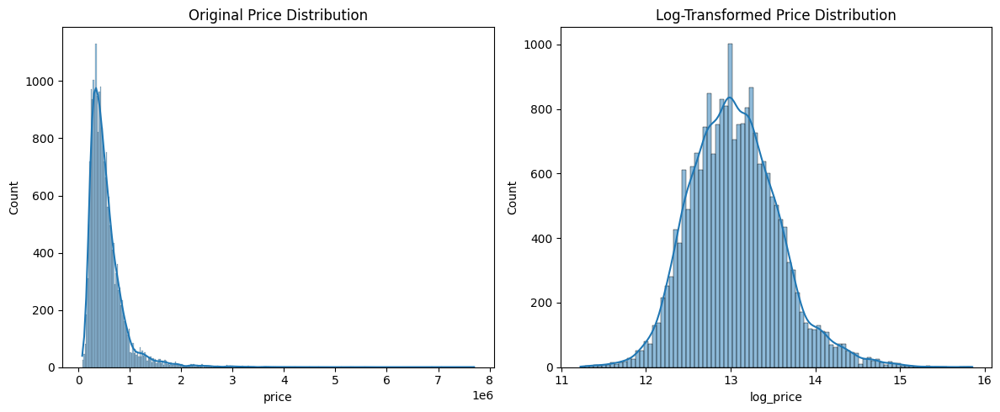

In [15]:
df['log_price'] = np.log1p(df['price'])
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.histplot(df['price'], kde=True)
plt.title('Original Price Distribution')

plt.subplot(1, 2, 2)
sns.histplot(df['log_price'], kde=True)
plt.title('Log-Transformed Price Distribution')

plt.tight_layout()
plt.show()

In [16]:
df['zipcode'] = df['zipcode'].astype(str).str.zfill(5)

avg_price_zip = df.groupby('zipcode')['price'].mean().reset_index()
avg_price_zip.columns = ['ZCTA5CE10', 'avg_price']

avg_price_zip['tooltip_price'] = avg_price_zip['avg_price'].apply(lambda x: f"${x:,.0f}")

geo_url = "https://raw.githubusercontent.com/OpenDataDE/State-zip-code-GeoJSON/master/wa_washington_zip_codes_geo.min.json"
wa_gdf = gpd.read_file(geo_url)
king_gdf = wa_gdf[wa_gdf['ZCTA5CE10'].isin(avg_price_zip['ZCTA5CE10'])]

king_gdf = king_gdf.merge(avg_price_zip, on='ZCTA5CE10', how='left')

filtered_geo_path = "data/filtered_king_county.geojson"
king_gdf.to_file(filtered_geo_path, driver="GeoJSON")


m = folium.Map(location=[47.55, -122.25], zoom_start=10, tiles='CartoDB positron')

folium.Choropleth(
    geo_data=filtered_geo_path,
    name='Choropleth',
    data=avg_price_zip,
    columns=['ZCTA5CE10', 'avg_price'],
    key_on='feature.properties.ZCTA5CE10',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Average House Price ($)',
    highlight=True,
    nan_fill_color='white'
).add_to(m)

folium.GeoJson(
    king_gdf,
    name='Zip Code Tooltip',
    tooltip=folium.GeoJsonTooltip(
        fields=['ZCTA5CE10', 'tooltip_price'],
        aliases=['Zip Code:', 'Avg Price:'],
        localize=True
    ),
    style_function=lambda x: {'fillOpacity': 0, 'color': 'black', 'weight': 0.3}
).add_to(m)

title_html = '''
     <h3 align="center" style="font-size:20px"><b>King County - Average House Prices by Zipcode</b></h3>
     '''
m.get_root().html.add_child(folium.Element(title_html))

m

In [17]:
df_map = df[['lat', 'long', 'price']].dropna().copy()

kmeans = KMeans(n_clusters=5, random_state=42)
df_map['price_cluster'] = kmeans.fit_predict(df_map[['lat', 'long', 'price']])

cluster_avg_price = df_map.groupby('price_cluster')['price'].mean().round(0).astype(int)
df_map['cluster_avg_price'] = df_map['price_cluster'].map(cluster_avg_price)

colors = ['red', 'blue', 'green', 'purple', 'orange']
cluster_color = df_map['price_cluster'].map(dict(zip(range(5), colors)))

m = folium.Map(location=[47.5, -122.2], zoom_start=10, tiles='CartoDB positron')
marker_cluster = MarkerCluster().add_to(m)

for i, row in df_map.iterrows():
    folium.CircleMarker(
        location=(row['lat'], row['long']),
        radius=3,
        fill=True,
        color=cluster_color[i],
        fill_opacity=0.7,
        tooltip=f"Price: ${int(row['price']):,} | Cluster Avg: ${row['cluster_avg_price']:,}"
    ).add_to(marker_cluster)

legend_items = ''.join([
    f'<i style="color:{colors[i]}">●</i> Cluster {i} Avg: ${cluster_avg_price[i]:,}<br>'
    for i in range(5)
])

legend_html = f'''
<div style="position: fixed; 
     bottom: 40px; left: 40px; width: 250px; height: auto; 
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white; padding:10px;">
     <b>Price Clusters (Avg)</b><br>
     {legend_items}
</div>
'''

m.get_root().html.add_child(folium.Element(legend_html))

m